# Set Up the meta 

In [1]:
from osgeo import ogr, osr

In [2]:
driver = ogr.GetDriverByName('ESRI Shapefile')

In [3]:
dataset = driver.Open("/home/smitesh22/Data/GIS Extracted/N19E072_wgs84/planet_72,19_73,20-shp/shape/", 0)

In [4]:
layer_types = {
              0:'places',
              1: 'railway',
              2:'landuse',
              3:'natural',
              4:'point',
              5:'waterway',
              6:'road',
              7:'buildings'}

In [5]:
layer_metadata = {}
for num in layer_types:
    layer = dataset.GetLayer(num)
    
    attributes = []
    for feature in layer:
        attributes.append(feature.items())
    meta = set()
    
    for attr in attributes:
        #print(attr['type'])
        meta.add(attr['type'])
        
        
    layer_metadata[layer_types[num]] = meta

In [6]:
layer_metadata

{'places': {'borough',
  'city',
  'farm',
  'hamlet',
  'island',
  'locality',
  'neighbourhood',
  'plot',
  'suburb',
  'town',
  'village',
  'yes'},
 'railway': {'abandoned',
  'construction',
  'disused',
  'miniature',
  'monorail',
  'platform',
  'platform_edge',
  'proposed',
  'rail',
  'subway',
  'traverser',
  'turntable',
  'workshop'},
 'landuse': {'allotments',
  'aquaculture',
  'barren',
  'basin',
  'brownfield',
  'cemetery',
  'commercial',
  'construction',
  'education',
  'farmland',
  'farmyard',
  'garages',
  'garden',
  'grass',
  'green',
  'greenfield',
  'industrial',
  'landfill',
  'meadow',
  'military',
  'orchard',
  'parking',
  'plant_nursery',
  'quarry',
  'railway',
  'recreation_groun',
  'religious',
  'reservoir',
  'residential',
  'retail',
  'salt_pond',
  'saltpond',
  'used by school a',
  'vacant',
  'village_green',
  'yes'},
 'natural': {'forest', 'park', 'water'},
 'point': {'Drinking Water F',
  'The Wall',
  'animal_boarding',
  

### Create Plot

In [7]:
import geopandas as gpd
import matplotlib.pyplot as plt

In [8]:
shapefile_path = "/home/smitesh22/Data/GIS Extracted/N19E072_wgs84/planet_72,19_73,20-shp/shape/buildings.shp"
gdf = gpd.read_file(shapefile_path)

In [9]:
gdf

,osm_id,name,type,geometry
0,27036332,Siddhivinayak Mandir,place_of_worship,"POLYGON ((72.83040 19.01698, 72.83051 19.01684..."
1,27054842,NaN,NaN,"POLYGON ((72.81644 19.13172, 72.81667 19.13128..."
2,27083473,Jayanti Jagannath Pendre Park,NaN,"POLYGON ((72.81234 19.13427, 72.81299 19.13460..."
3,38991543,Trade View,NaN,"POLYGON ((72.82622 19.00582, 72.82650 19.00582..."
4,39352981,Mahindra Towers,NaN,"POLYGON ((72.82142 19.00538, 72.82156 19.00560..."
...,...,...,...,...
113618,1188341339,NaN,NaN,"POLYGON ((72.83517 19.20096, 72.83521 19.20096..."
113619,1188341340,NaN,NaN,"POLYGON ((72.83516 19.20099, 72.83517 19.20101..."
113620,1188341341,NaN,NaN,"POLYGON ((72.83521 19.20096, 72.83521 19.20098..."
113621,1188341342,NaN,NaN,"POLYGON ((72.83490 19.20110, 72.83490 19.20112..."


In [10]:
gdf = gdf.to_crs("EPSG:3857")

In [11]:
#100 meters buffer
gdf['geometry'] = gdf['geometry'].buffer(100)

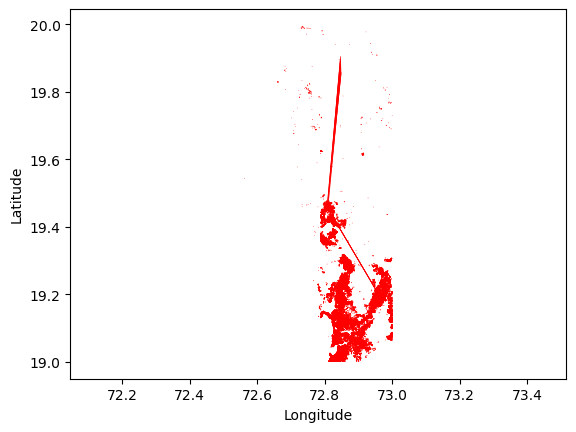

In [12]:
# Convert the GeoDataFrame to a geographic CRS if it's not already
# WGS 84 (EPSG:4326) is a common choice that uses degrees for latitude and longitude
gdf = gdf.to_crs(epsg=4326)

# Plot the data
gdf.plot(color='red')

# Add labels for clarity
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Ensure that the axes are equally scaled
plt.axis('equal')

# Show the plot
plt.show()

In [13]:
gdf

,osm_id,name,type,geometry
0,27036332,Siddhivinayak Mandir,place_of_worship,"POLYGON ((72.82987 19.01611, 72.82987 19.01611..."
1,27054842,NaN,NaN,"POLYGON ((72.81604 19.13248, 72.81651 19.13269..."
2,27083473,Jayanti Jagannath Pendre Park,NaN,"POLYGON ((72.81155 19.13387, 72.81130 19.13432..."
3,38991543,Trade View,NaN,"POLYGON ((72.82532 19.00582, 72.82533 19.00590..."
4,39352981,Mahindra Towers,NaN,"POLYGON ((72.82097 19.00465, 72.82090 19.00469..."
...,...,...,...,...
113618,1188341339,NaN,NaN,"POLYGON ((72.83429 19.20113, 72.83431 19.20121..."
113619,1188341340,NaN,NaN,"POLYGON ((72.83503 19.20015, 72.83494 19.20017..."
113620,1188341341,NaN,NaN,"POLYGON ((72.83506 19.20012, 72.83502 19.20012..."
113621,1188341342,NaN,NaN,"POLYGON ((72.83400 19.20110, 72.83400 19.20111..."


In [14]:
import re
import pandas as pd
import glob

def get_suitable_area(shapefile_path, buffer):
    """
    params : shapefile_path : location where shp files for the geolocations are present
             buffer : buffer distance in meters
    
    output : Geodataframe with features needed to be considered along with a buffer of 100 meters
    
    """
    
    gdfs = []
    
    #shapefile_path = "/home/smitesh22/Data/GIS Extracted/N19E072_wgs84/planet_72,19_73,20-shp/shape/landuse.shp"
    
    #get all the shapefiles available for the geolocation
    shape_files = glob.glob(f'{shapefile_path}*.shp')
    
    #loop over each shape file
    for shape_file in shape_files:
        
        match = re.search(r'([^/]+)\.shp$', shape_file)
        #feature to identiy layer
        feature = match.group(1)
        
        #print(shape_file)
        gdf = gpd.read_file(shape_file)
        
        #EPSG:3395 (World Mercator) uses metric system
        gdf = gdf.to_crs(epsg=3395)
        
        #add a buffer of 100 meters
        gdf['geometry'] = gdf['geometry'].buffer(buffer)
        
        #conditions on each layer to select CERTAIN attribute values only
        if feature == "places":
            pass
        elif feature == "landuse":
            filtered_gdf = gdf[~gdf['type'].isin(['vacant', 'barren'])]
        elif feature == "natural":
            pass
        
        filtered_gdf = gdf
        
        filtered_gdf['feature'] = feature
        
        gdfs.append(filtered_gdf)
        
        # Concatenate all the GeoDataFrames in the list
        combined_gdf = pd.concat(gdfs, ignore_index=True)
        
        #print(combined_gdf)
    return combined_gdf

In [15]:
combined_gdf = get_suitable_area("/home/smitesh22/Data/GIS Extracted/N19E072_wgs84/planet_72,19_73,20-shp/shape/", 100)

In [16]:
combined_gdf

,osm_id,name,type,population,geometry,feature,timestamp,width,ref,oneway,bridge,maxspeed
0,16173235,Mumbai,city,12442373.0,"POLYGON ((8112861.442 2150225.852, 8112860.961...",places,NaN,NaN,NaN,NaN,NaN,NaN
1,245659664,Ambedkar Nagar,neighbourhood,NaN,"POLYGON ((8109447.685 2141499.627, 8109447.204...",places,NaN,NaN,NaN,NaN,NaN,NaN
2,245659875,New Police Lines,locality,NaN,"POLYGON ((8109432.334 2141789.095, 8109431.853...",places,NaN,NaN,NaN,NaN,NaN,NaN
3,245659921,Police Camp,locality,NaN,"POLYGON ((8105850.986 2141839.138, 8105850.504...",places,NaN,NaN,NaN,NaN,NaN,NaN
4,245660095,Kidwai Nagar,locality,NaN,"POLYGON ((8110056.781 2142018.856, 8110056.300...",places,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
180380,1188341339,NaN,NaN,NaN,"POLYGON ((8107875.753 2164584.666, 8107878.128...",buildings,NaN,NaN,NaN,NaN,NaN,NaN
180381,1188341340,NaN,NaN,NaN,"POLYGON ((8107958.087 2164468.602, 8107948.672...",buildings,NaN,NaN,NaN,NaN,NaN,NaN
180382,1188341341,NaN,NaN,NaN,"POLYGON ((8107962.234 2164464.964, 8107957.792...",buildings,NaN,NaN,NaN,NaN,NaN,NaN
180383,1188341342,NaN,NaN,NaN,"POLYGON ((8107843.512 2164581.023, 8107843.519...",buildings,NaN,NaN,NaN,NaN,NaN,NaN


In [17]:
# Calculate the total area
total_area = combined_gdf['geometry'].area.sum()

# Print the result
print(f"The total area is {total_area/1000} square units.")

The total area is 11243470.120515523 square units.


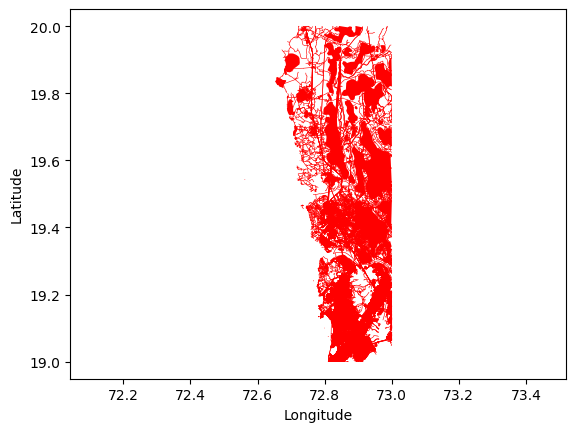

In [18]:
# Convert the GeoDataFrame to a geographic CRS if it's not already
# WGS 84 (EPSG:4326) is a common choice that uses degrees for latitude and longitude
combined_gdf = combined_gdf.to_crs(epsg=4326)

# Plot the data
combined_gdf.plot(color='red')

# Add labels for clarity
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Ensure that the axes are equally scaled
plt.axis('equal')

# Show the plot
plt.show()

In [19]:
def calculate_middle_coordinates(lat_ul, lon_ul, lat_lr, lon_lr):
    upper_middle = ((lat_ul + lat_lr) / 2, lon_ul)
    left_middle = (lat_ul, (lon_ul + lon_lr) / 2)
    right_middle = (lat_lr, (lon_ul + lon_lr) / 2)
    lower_middle = ((lat_ul + lat_lr) / 2, lon_lr)
    
    return upper_middle, left_middle, right_middle, lower_middle

# Example usage:
lat_ul = 16.0001388888888
lon_ul = 79.0001388888889
lat_lr = 14.9998611111111
lon_lr = 77.9998611111111



In [20]:
combined_gdf

,osm_id,name,type,population,geometry,feature,timestamp,width,ref,oneway,bridge,maxspeed
0,16173235,Mumbai,city,12442373.0,"POLYGON ((72.87907 19.07855, 72.87907 19.07846...",places,NaN,NaN,NaN,NaN,NaN,NaN
1,245659664,Ambedkar Nagar,neighbourhood,NaN,"POLYGON ((72.84841 19.00400, 72.84840 19.00392...",places,NaN,NaN,NaN,NaN,NaN,NaN
2,245659875,New Police Lines,locality,NaN,"POLYGON ((72.84827 19.00647, 72.84827 19.00639...",places,NaN,NaN,NaN,NaN,NaN,NaN
3,245659921,Police Camp,locality,NaN,"POLYGON ((72.81610 19.00690, 72.81609 19.00682...",places,NaN,NaN,NaN,NaN,NaN,NaN
4,245660095,Kidwai Nagar,locality,NaN,"POLYGON ((72.85388 19.00844, 72.85388 19.00835...",places,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
180380,1188341339,NaN,NaN,NaN,"POLYGON ((72.83429 19.20114, 72.83431 19.20121...",buildings,NaN,NaN,NaN,NaN,NaN,NaN
180381,1188341340,NaN,NaN,NaN,"POLYGON ((72.83503 19.20014, 72.83494 19.20016...",buildings,NaN,NaN,NaN,NaN,NaN,NaN
180382,1188341341,NaN,NaN,NaN,"POLYGON ((72.83506 19.20011, 72.83502 19.20012...",buildings,NaN,NaN,NaN,NaN,NaN,NaN
180383,1188341342,NaN,NaN,NaN,"POLYGON ((72.83400 19.20110, 72.83400 19.20111...",buildings,NaN,NaN,NaN,NaN,NaN,NaN


In [21]:
import folium

# Define the South-West and North-East coordinates
sw_latitude = 19
sw_longitude = 72
ne_latitude = 20
ne_longitude = 73

# Calculate center latitude and longitude
center_latitude = (sw_latitude + ne_latitude) / 2
center_longitude = (sw_longitude + ne_longitude) / 2

# Create the folium map at the center
m = folium.Map(location=[center_latitude, center_longitude], zoom_start=10)

# Add a rectangle to the map with the South-West and North-East coordinates
folium.Rectangle(
    bounds=[(sw_latitude, sw_longitude), (ne_latitude, ne_longitude)],
    color="#ff7800",
    fill=True,
    fill_color="#ffff00",
    fill_opacity=0.2,
).add_to(m)

# Display the map in Jupyter or save to a file
m


In [22]:
import folium
import geopandas as gpd
from shapely.geometry import Polygon

# Assuming `gdf` is your GeoPandas DataFrame
# gdf = ...

# Calculate center latitude and longitude
center_latitude = (sw_latitude + ne_latitude) / 2
center_longitude = (sw_longitude + ne_longitude) / 2

# Create a folium map at the center
m = folium.Map(location=[center_latitude, center_longitude], zoom_start=10)

# Highlight the defined area with a rectangle
folium.Rectangle(
    bounds=[(sw_latitude, sw_longitude), (ne_latitude, ne_longitude)],
    color="#ff7800",
    fill=True,
    fill_color="#ffff00",
    fill_opacity=0.2,
).add_to(m)

combined_gdf = combined_gdf.head(10000)

# Plot the GeoPandas DataFrame on the map
for _, row in combined_gdf.iterrows():
    if row['geometry'] is not None:
        folium.GeoJson(row['geometry']).add_to(m)

# Display the map in Jupyter or save to a file
m
